# Exploratory Data Analysis

__Caveat:__ Prior to running this notebook, please run the notebook _Cleaning-and-Feature-Extraction_ to have the query and a cleaned dataset at hand

In [1]:
# import pkgs necessary for analysis
%load_ext autoreload
%autoreload 2
import sys
import utils
import numpy as np
import pandas as pd
import geopandas as gpd
pd.set_option('display.max_columns', 60)
pd.set_option('display.max_rows', 100)
from IPython.display import display
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
sns.set(style = 'darkgrid', color_codes = True)
sns.set_context("notebook", font_scale = 1.1)
plt.rcParams['savefig.dpi'] = 800
plt.rcParams['figure.figsize'] = 14, 10
%config InlineBackend.figure_format = "retina"

import data
import models
from features import CYCLE_DAY, CYCLE_WEEK, CYCLE_YEAR
from viz import cyclic_chart

# extra functions vasan imported in his notebook
import os
import gmplot
import descartes
import mysql.connector
import geopy
import math
from geopy import distance

In [2]:
# load data
df = pd.read_feather(utils.path_to('data', 'final', 'df_clean_jobs.feather'))

Now that we have queried the data from Gophr's database – and applied the cleaning function – in the previous notebook, we can begin exploring the data. To begin with, let's get some summary information about the data frame (table of data) that we are working with.

In [3]:
print(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 138945 entries, 0 to 138944
Data columns (total 60 columns):
 #   Column                    Non-Null Count   Dtype         
---  ------                    --------------   -----         
 0   job_id                    138945 non-null  int64         
 1   status                    138945 non-null  int64         
 2   pickup_postcode           138945 non-null  object        
 3   pickup_location_lat       138945 non-null  float64       
 4   pickup_location_lng       138945 non-null  float64       
 5   delivery_postcode         138945 non-null  object        
 6   delivery_location_lat     138945 non-null  float64       
 7   delivery_location_lng     138945 non-null  float64       
 8   distance                  138945 non-null  float64       
 9   insertion_date            138945 non-null  datetime64[ns]
 10  earliest_pickup_time      138945 non-null  datetime64[ns]
 11  delivery_deadline         138945 non-null  datetime64[ns]
 12  da

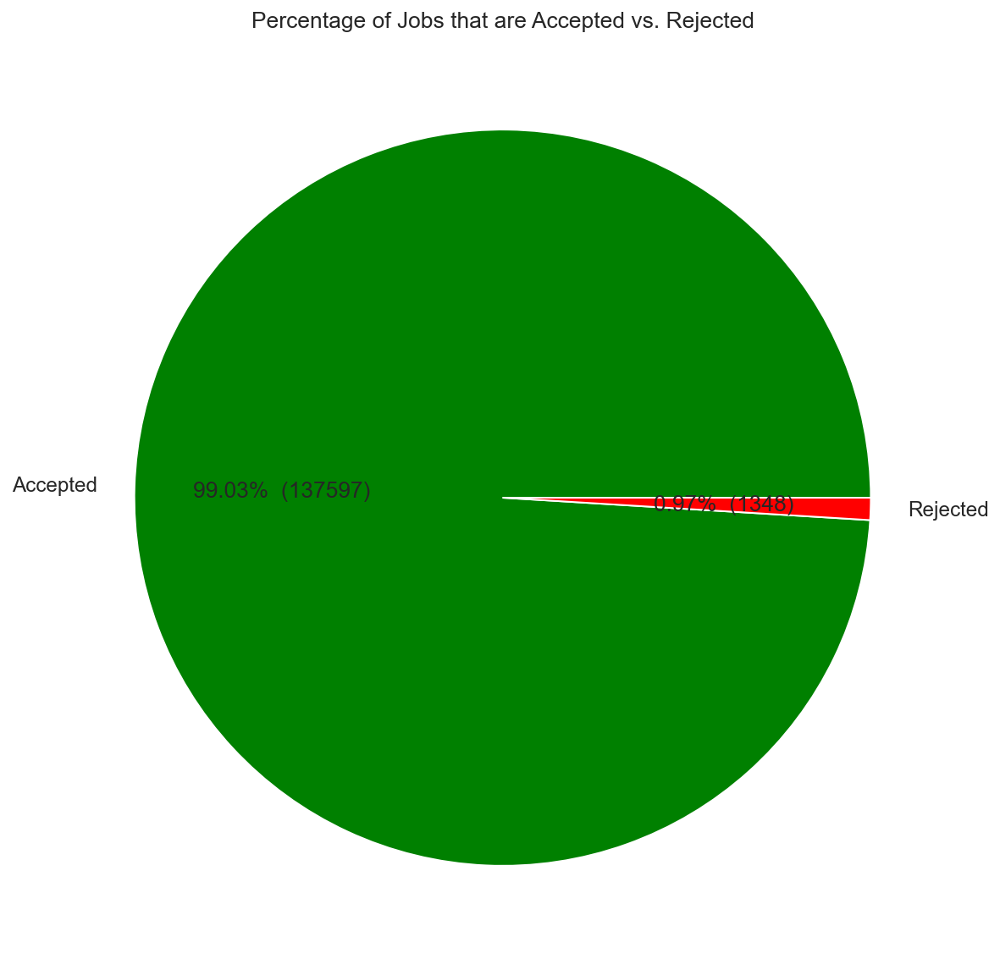

In [4]:
# Define labels, values and colours for pie chart below
labels = ['Accepted', 'Rejected']
values = df['is_accepted'].value_counts()
colors = ['Green', 'Red']

# Write function to show percentages as well as value count for pie chart
def make_autopct(values):
    def my_autopct(pct):
        total = sum(values)
        val = int(round(pct*total/100.0))
        return '{p:.2f}%  ({v:d})'.format(p=pct,v=val)
    return my_autopct

# Plot pie chart of accepted vs. rejected jobs
plt.pie(values, labels=labels, colors = colors, autopct=make_autopct(values))
plt.title('Percentage of Jobs that are Accepted vs. Rejected')
plt.show()

As can be seen from the pie chart above, the the vast majority of jobs eventually get accepted by a courier.

In [5]:
# Function to get descriptive statistics of selected columns
def show_descriptive_df(df, cols):
    
    # Descrptive stats for columns specified in the list cols
    df_describe = df.describe()[cols]
    
    return df_describe

In [6]:
# Specify columns to summarize
columns = ['rejected_count', 'courier_money_earned_net','distance', 'size_x', 'size_y', 'size_z', 'weight']

By changing the column names listed above, you can vary which columns in the databse to get descriptive statistics for.

__Descriptive statistics for all jobs:__

In [7]:
show_descriptive_df(df, columns)

,rejected_count,courier_money_earned_net,distance,size_x,size_y,size_z,weight
count,138945.000000,138945.000000,138945.000000,138945.000000,138945.000000,138945.000000,138945.000000
mean,1.285602,11.979006,5.851064,38.111109,27.504510,15.661567,6.620446
std,4.262778,18.586122,4.177509,23.007281,14.194712,14.417920,16.620562
min,0.000000,-0.140000,0.001000,1.000000,1.000000,0.500000,0.012000
25%,0.000000,5.580000,2.920000,25.000000,20.000000,2.500000,0.750000
50%,0.000000,7.560000,4.773000,35.000000,25.000000,15.000000,1.500000
75%,1.000000,12.080000,7.629000,40.000000,30.000000,20.000000,6.300000
max,135.000000,220.020000,50.602000,450.000000,274.320000,250.000000,1140.000000


__Descriptive statistics for accepted jobs only:__

In [8]:
show_descriptive_df(df[df['is_accepted'] == 1], columns)

,rejected_count,courier_money_earned_net,distance,size_x,size_y,size_z,weight
count,137597.000000,137597.000000,137597.000000,137597.000000,137597.000000,137597.000000,137597.000000
mean,1.209561,12.088756,5.855477,38.062602,27.479088,15.632884,6.631335
std,3.970554,18.641989,4.183967,22.871845,14.142145,14.393408,16.627861
min,0.000000,-0.140000,0.001000,1.000000,1.000000,0.500000,0.012000
25%,0.000000,5.680000,2.918000,25.000000,20.000000,2.500000,0.750000
50%,0.000000,7.610000,4.775000,35.000000,25.000000,15.000000,1.500000
75%,1.000000,12.180000,7.642000,40.000000,30.000000,20.000000,6.400000
max,135.000000,220.020000,50.602000,450.000000,274.320000,250.000000,1140.000000


__Descriptive statistics for rejected jobs only:__

In [9]:
show_descriptive_df(df[df['is_accepted'] == 0], columns)

,rejected_count,courier_money_earned_net,distance,size_x,size_y,size_z,weight
count,1348.000000,1348.000000,1348.000000,1348.000000,1348.000000,1348.000000,1348.000000
mean,9.047478,0.776239,5.400650,43.062463,30.099407,18.589392,5.508939
std,14.250359,2.533845,3.426937,33.759193,18.627800,16.477504,15.824281
min,0.000000,0.000000,0.094000,10.000000,5.000000,0.500000,0.100000
25%,2.000000,0.000000,3.062750,25.000000,20.000000,2.500000,0.750000
50%,4.000000,0.000000,4.523500,35.000000,25.000000,15.000000,1.500000
75%,10.000000,0.000000,6.906500,40.000000,30.000000,30.000000,5.000000
max,117.000000,26.320000,31.364000,400.000000,150.000000,80.000000,350.000000


In [10]:
def plot_prob_distribution (y, x_lim, ax_label, title):
    
    fig, ax = plt.subplots(figsize=(11,7))
    plt.xlim(0,x_lim)#can be: plt.xlim(0,df.rejected_count.max())
    plt.title(title)
    plt.ylabel('Probability Density')
    
    return(sns.distplot(ax = ax, a = y, axlabel=ax_label))

In [11]:
df2=df.copy()

Text(0.5, 0, 'courier_money_earned_net')

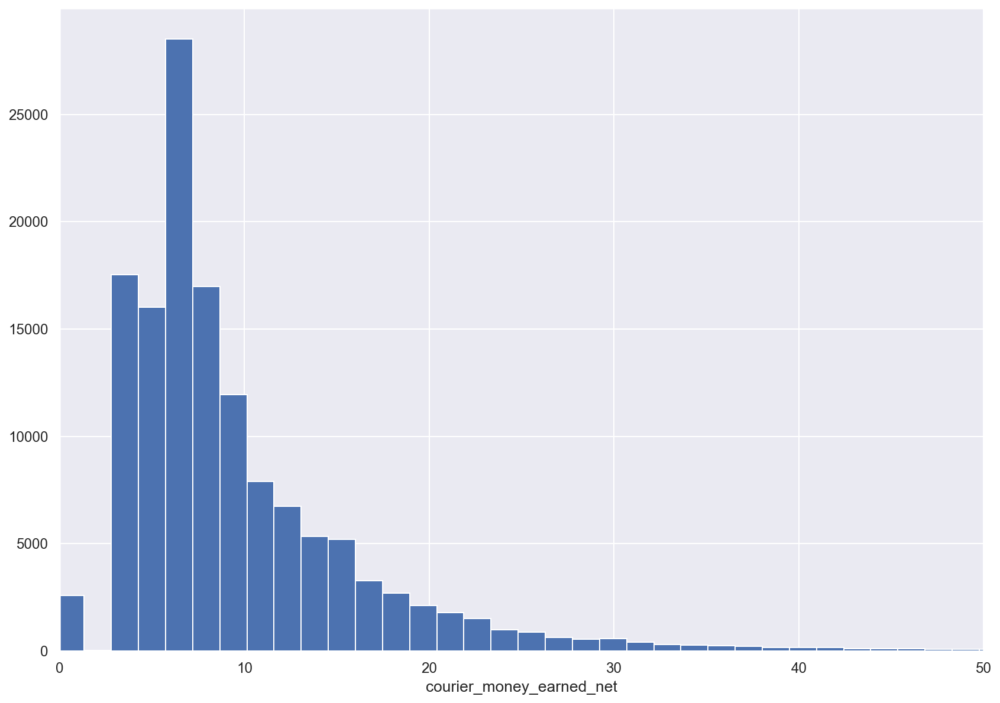

In [12]:
fig, ax = plt.subplots()
df2['courier_money_earned_net'].hist(ax=ax, bins=150)
ax.set_xlim(0,50)
ax.set_xlabel('courier_money_earned_net')

## Location Data

Let's start exploring the location data. To begin with, let's see the dsitribution of distances between the pickup and drop-off location.

Text(0.5, 0, 'Distance between pickup and drop location, km')

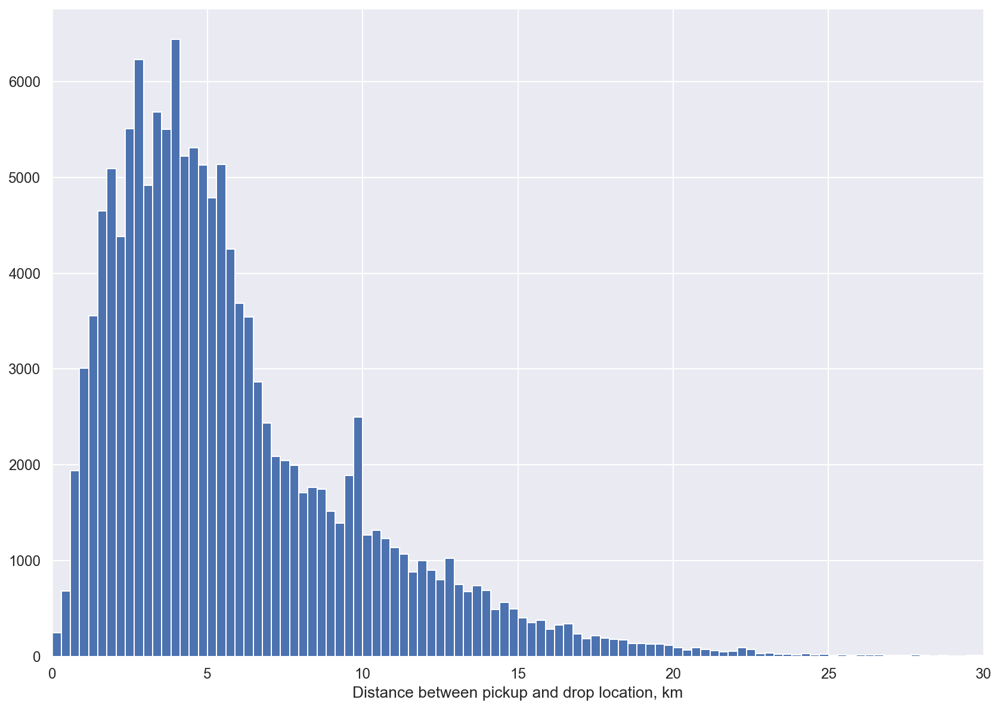

In [13]:
fig, ax = plt.subplots()
df2['distance'].hist(ax=ax, bins=172)
ax.set_xlim(0,30)
ax.set_xlabel('Distance between pickup and drop location, km')

The code below is used to construct the London postcode map plots that shortly follow.

In [14]:
# to calculate the pickup and drop off locations from the London city centre
def calc_distance_pick (x):
    London_coords = (51.509865, -0.118092)
    pick_coords = (x.pickup_location_lat, x.pickup_location_lng)
    return (geopy.distance.distance(London_coords, pick_coords).km)
df2['pickup_dist_from_centre'] = df2.apply(calc_distance_pick, axis = 1)
def calc_distance_deliv(x):
    London_coords = (51.509865, -0.118092)
    deliv_coords = (x.delivery_location_lat, x.delivery_location_lng)
    return (geopy.distance.distance(London_coords, deliv_coords).km)
df2['deliv_dist_from_centre']=df2.apply(calc_distance_deliv, axis = 1)

In [15]:
# code for downloading the zip code shape files
file_name = 'GB_Postcodes.zip'
url = 'https://datashare.is.ed.ac.uk/bitstream/handle/10283/2597/GB_Postcodes.zip?sequence=1&isAllowed=y' #url for the GB_Postcodes.zip
data.downloading_scripts(file_name,url)

file downloaded


In [16]:
#code for unzipping the downloaded zip file
file_name = 'GB_Postcodes.zip'
data.unzipping_zip_files(file_name)

file unzipped


In [17]:
file_name = 'postcode_outcodes.csv'
url = 'https://www.freemaptools.com/download/outcode-postcodes/postcode-outcodes.csv' #url for postcodes and their lat, long values
data.downloading_scripts(file_name,url)

file downloaded


In [18]:
dir_name = utils.path_to('data','external','GB_Postcodes')
file_name = 'PostalDistrict.shp'
file_path=os.path.join(dir_name,file_name)
GB_PoD_df=gpd.read_file(file_path) #load the shape files in GB_Postcodes as geopandas(gpd) data frame file

In [19]:
#GB_PoD_df is the data frame containing postal district shape files of whole of Great Britain
#London_PoD_df is the data frame containing postal district shape files of London
#To filter the London Postal districts from GB, I used if the Post Area (one level hierarchy above Postal Districts) is in one of teh following categories East Central, West Central, East, North, North-West, South East, South West and West
London_PoD_df=GB_PoD_df[GB_PoD_df['PostArea'].isin(['EC', 'WC', 'E', 'N', 'NW', 'SE', 'SW', 'W'])]

In [20]:
original_London_PostDist = London_PoD_df['PostDist'].tolist()

In [21]:
# Finding the unique pick up postcodes
unique_pickup_postcodes=df2['pickup_postcode_outer'].unique().tolist()

In [22]:
# finding out the postcodes that are different from the original London_PostDist
diff_post_code=list(set(unique_pickup_postcodes)-set(original_London_PostDist))

In [23]:
#storing the outer postcode counts as a variable
outer_postcode_count=df2['pickup_postcode_outer'].value_counts()

In [24]:
#the outerpostcode value_counts is a series with index of postcodes and the corresponding number of occurences, we separate the index and value as index_pc and value_pc
index_pc=outer_postcode_count.index.to_list()
value_pc=outer_postcode_count.to_list()

In [25]:
#Determine which indices of postcode in outer_postcode_count are different from original London Post codes
match_index =[i for i, item in enumerate(index_pc) if item in diff_post_code]

In [26]:
#We create a dictionary and populate it with the postcodes that differ from original London Postcodes and the number of occurences in pickup
value_diff_postcode={}
d_pc=0
for i in match_index:
    value_diff_postcode[index_pc[i]] = value_pc[i]
    d_pc+=value_pc[i]

In [27]:
#delete the different post code's index
for i in sorted(match_index, reverse=True):
    del(index_pc[i])

In [28]:
#similaryly delete the corresponding entries of those different post codes
for i in sorted(match_index, reverse=True):
    del(value_pc[i])

In [29]:
#Create a London_pc_freq dataframe with Post District and the frequency of occurences
London_pc_freq=pd.DataFrame()
London_pc_freq['PostDist'] = index_pc
London_pc_freq['Number_Pickups'] = value_pc

In [30]:
#Merging the London_PoD_df and athe postcodes frequency over the column 'PostDist' to have a new dataframe
pickup_points_pc=London_PoD_df.merge(London_pc_freq, left_on = 'PostDist', right_on = 'PostDist')

In [31]:
# Add a column with percentage for easier visualization and comprehension
pickup_points_pc['Number_Pickups_perc']=((pickup_points_pc['Number_Pickups']*100)/(pickup_points_pc['Number_Pickups'].sum())).round(decimals=2)

In [32]:
# set the range for the choropleth
#vmin, vmax = 0, 220
# create figure and axes for Matplotlib
fig, ax = plt.subplots(1, figsize=(80, 80))
pickup_points_pc.plot(column='Number_Pickups', cmap='Oranges', linewidth=0.8, ax=ax, edgecolor='0.8')
pickup_points_pc.apply(lambda x: ax.annotate(s=x['Number_Pickups_perc'], xy=x.geometry.centroid.coords[0], ha='center', size=30),axis=1)
ax.axis('off')
ax.set_title('GOPHR Packages Picked up in London Postcode Districts as % of total', fontdict={'fontsize': '100', 'fontweight' : '5'})

Text(0.5, 1.0, 'GOPHR Packages Picked up in London Postcode Districts as % of total')

In [33]:
post_area_count=pickup_points_pc.groupby('PostArea')['Number_Pickups'].sum()

In [34]:
# Number of Pickups by Post Area
post_area_count_df=post_area_count.reset_index()

In [35]:
dir_name = utils.path_to('data', 'external','GB_Postcodes')
file_name = 'PostalArea.shp'
file_path=os.path.join(dir_name,file_name)
GB_df=gpd.read_file(file_path) # Taking the shape file as geopandas data frame

In [36]:
#Using the the regional filter to extract London Post Areas from GB Post Areas
GB_London_df = GB_df[GB_df['PostArea'].isin(['EC', 'WC', 'E', 'N', 'NW', 'SE', 'SW', 'W'])]

In [37]:
#Merging Pickup Post Areas with Post Area Shape files dataframe
pickup_points_PA_freq=GB_London_df.merge(post_area_count_df, left_on='PostArea', right_on='PostArea')

In [38]:
#Adding percentage for better visibility and comprehensibility
pickup_points_PA_freq['Number_Pickups_perc']=((pickup_points_PA_freq['Number_Pickups']*100)/(pickup_points_PA_freq['Number_Pickups'].sum())).round(decimals=2)

Text(0.5, 1.0, 'GOPHR Packages Picked up in London Postcode Areas as % of Total')

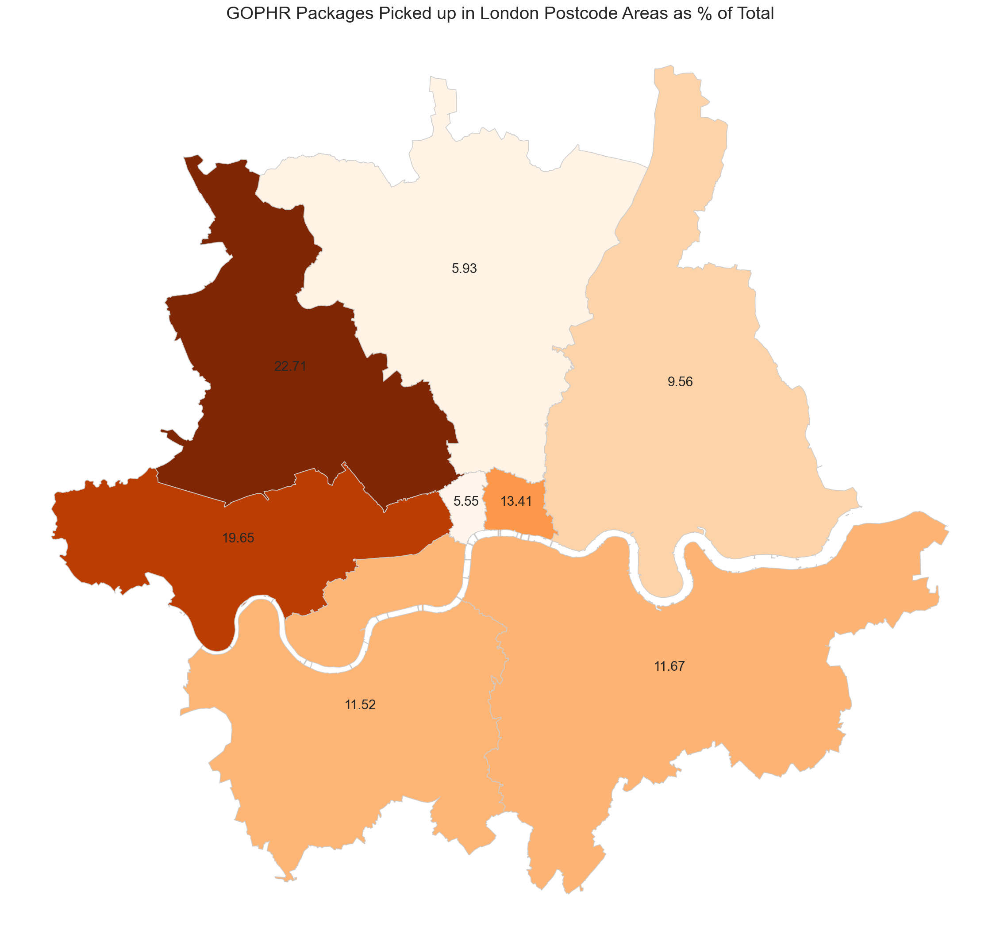

In [39]:
fig, ax =plt.subplots(figsize=(20,20))
pickup_points_PA_freq.plot(column='Number_Pickups', cmap='Oranges', linewidth=0.8, ax=ax, edgecolor='0.8')
pickup_points_PA_freq.apply(lambda x: ax.annotate(s=x['Number_Pickups_perc'], xy=x.geometry.centroid.coords[0], ha='center', size=15),axis=1)
ax.axis('off')
ax.set_title('GOPHR Packages Picked up in London Postcode Areas as % of Total', fontdict={'fontsize': '20', 'fontweight' : '5'})

In [40]:
# repeat the above steps from cell 50 for delivery postcodes
outer_postcode_count_delivery=df2['delivery_postcode_outer'].value_counts()

In [41]:
index_pc_delivery=outer_postcode_count_delivery.index.to_list()

In [42]:
value_pc_delivery=outer_postcode_count_delivery.to_list()

In [43]:
#repeat the same procedure for pickup post codes to clean the delivery postcodes
diff_post_code_delivery=list(set(index_pc_delivery)-set(original_London_PostDist))

In [44]:
match_index_delivery =[i for i, item in enumerate(index_pc_delivery) if item in diff_post_code_delivery]

In [45]:
value_diff_postcode_delivery={}
dd_pc=0
for i in match_index_delivery:
    value_diff_postcode_delivery[index_pc_delivery[i]] = value_pc_delivery[i]
    dd_pc+=value_pc_delivery[i]

In [46]:
for i in sorted(match_index_delivery, reverse=True):
    del(index_pc_delivery[i])

In [47]:
for i in sorted(match_index_delivery, reverse=True):
    del(value_pc_delivery[i])

In [48]:
London_pc_freq_delivery = pd.DataFrame({'PostDist':index_pc_delivery, 'Number_Delivery':value_pc_delivery})

In [49]:
delivery_points_pc=London_PoD_df.merge(London_pc_freq_delivery, left_on = 'PostDist', right_on = 'PostDist')

In [50]:
delivery_points_pc['Number_Delivery_perc']=((delivery_points_pc['Number_Delivery']*100)/(delivery_points_pc['Number_Delivery'].sum())).round(decimals=2)

In [51]:
fig, ax = plt.subplots(1, figsize=(80, 80))
delivery_points_pc.plot(column='Number_Delivery', cmap='Oranges', linewidth=0.8, ax=ax, edgecolor='0.8')
delivery_points_pc.apply(lambda x: ax.annotate(s=x['Number_Delivery_perc'], xy=x.geometry.centroid.coords[0], ha='center', size=30),axis=1)
ax.axis('off')
ax.set_title('GOPHR Packages Delivered in London Postcode Districts as % of total', fontdict={'fontsize': '100', 'fontweight' : '5'})

Text(0.5, 1.0, 'GOPHR Packages Delivered in London Postcode Districts as % of total')

In [52]:
post_area_count_delivery=delivery_points_pc.groupby('PostArea')['Number_Delivery'].sum()

In [53]:
post_area_count_delivery_df=post_area_count_delivery.reset_index()

In [54]:
post_area_count_delivery_df['Number_Delivery_perc'] = ((post_area_count_delivery_df['Number_Delivery']*100)/(post_area_count_delivery_df['Number_Delivery'].sum())).round(decimals=2)

In [55]:
delivery_points_PA_freq=GB_London_df.merge(post_area_count_delivery_df, left_on='PostArea', right_on='PostArea')

Text(0.5, 1.0, 'GOPHR Packages Delivered in London Postcode Areas as % of Total')

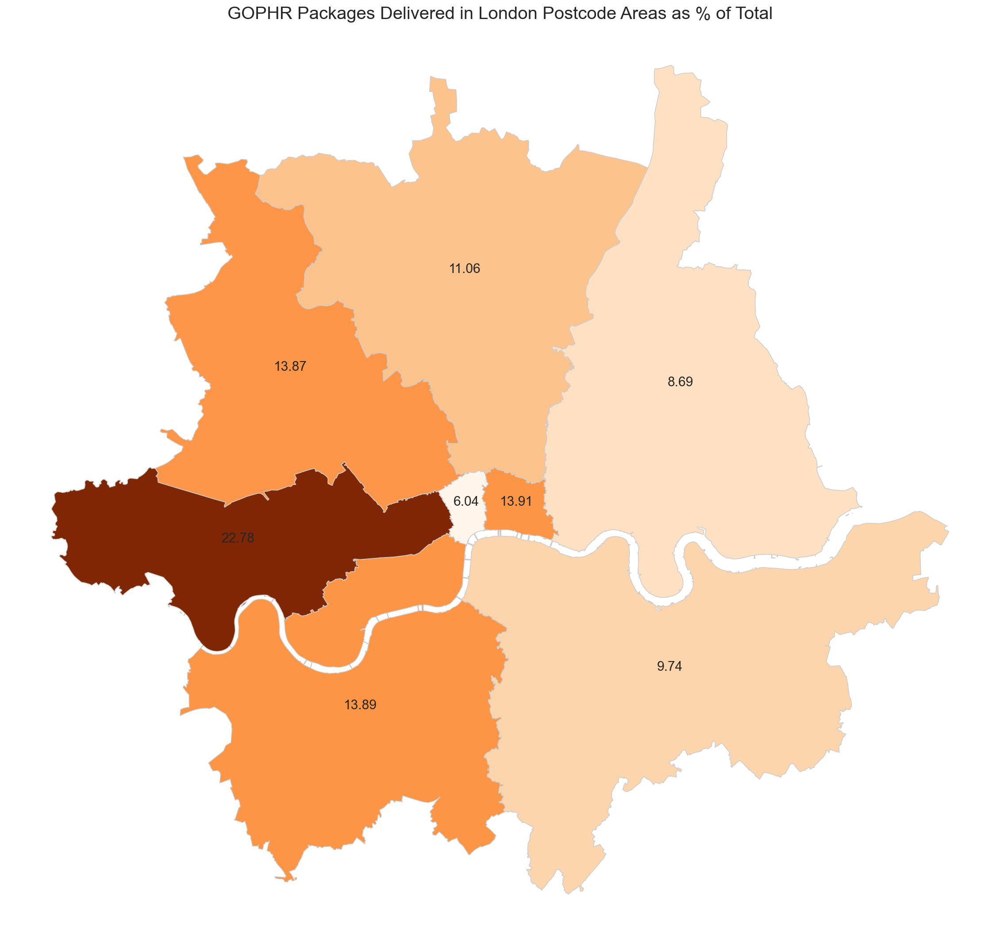

In [56]:
fig, ax =plt.subplots(figsize=(20,20))
delivery_points_PA_freq.plot(column='Number_Delivery', cmap='Oranges', linewidth=0.8, ax=ax, edgecolor='0.8')
delivery_points_PA_freq.apply(lambda x: ax.annotate(s=x['Number_Delivery_perc'], xy=x.geometry.centroid.coords[0], ha='center', size=15),axis=1)
ax.axis('off')
ax.set_title('GOPHR Packages Delivered in London Postcode Areas as % of Total', fontdict={'fontsize': '20', 'fontweight' : '5'})

In [57]:
#Reading the csv files where the postcode area and its central lat, long data
dir_name = utils.path_to('src', 'data')
file_name = 'postcode_outcodes.csv'
file_path=os.path.join(dir_name,file_name)
postcode_out_lat_lng = pd.read_csv(file_path)

In [58]:
#Filtering out London Postcodes Lat Long
London_pc_outer_lat_lng=postcode_out_lat_lng[postcode_out_lat_lng['postcode'].isin(original_London_PostDist)]

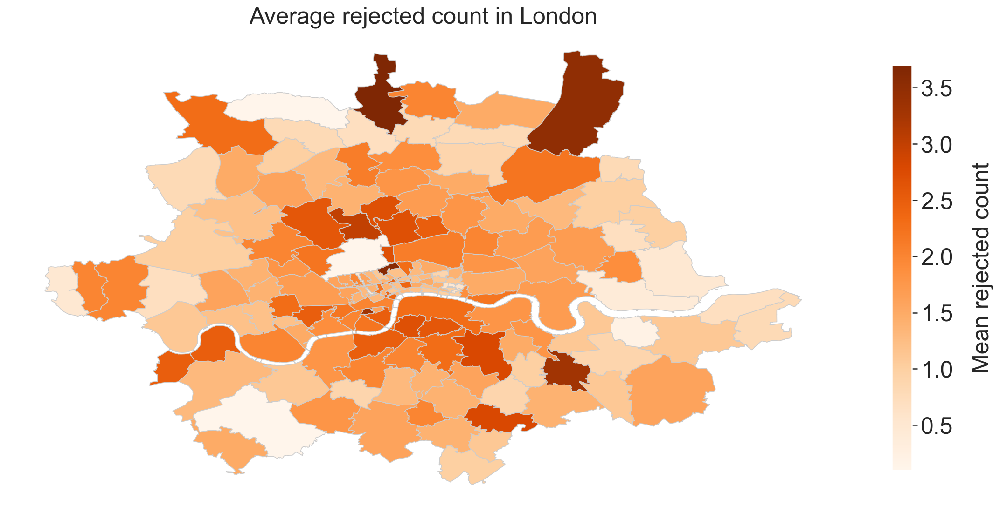

In [59]:
import viz

# get heatmap file
hm_gdb = viz.get_postcode_heatmap(df, target_str='rejected_count')

# plot heatmap
fig, ax =plt.subplots(1, figsize=(20,20))
h = hm_gdb.plot(column='rejected_count', cmap='Oranges', linewidth=0.8, ax=ax, edgecolor='0.8')
#hm_gdb.apply(lambda x:
#             ax.annotate(s=x['rejected_count'], xy=x.geometry.centroid.coords[0], ha='center', size=30),axis=1)
plt.title('Average rejected count in London',fontdict={'fontsize':25, 'fontweight': 6})

ax.axis('off')

# Create colorbar as a legend
sm = plt.cm.ScalarMappable(cmap='Oranges', norm=plt.Normalize(vmin=hm_gdb.rejected_count.min(), 
                                                              vmax=hm_gdb.rejected_count.max()))
# empty array for the data range
sm._A = []
# add the colorbar to the figure
cbar = fig.colorbar(sm, shrink=0.4)
cbar.ax.tick_params(labelsize=25)
cbar.set_label('Mean rejected count', rotation=90, fontsize=25)
cbar.ax.get_yaxis().labelpad = 20
plt.show()

fig.savefig('london_2.png', dpi=300)

c:\users\thilo\.conda\envs\s2ds\lib\site-packages\pyproj\crs\crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  return _prepare_from_string(" ".join(pjargs))


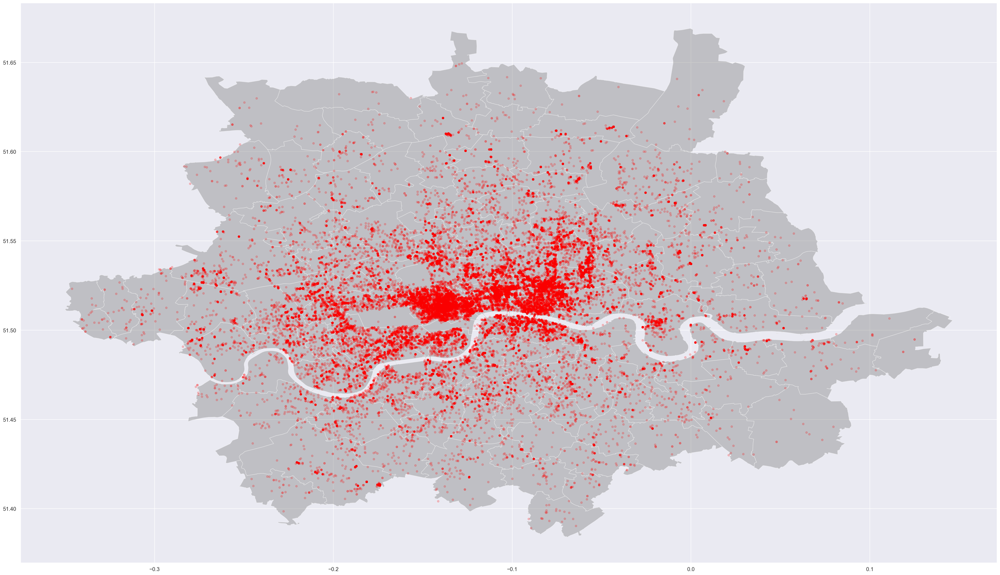

In [60]:
# get heatmap file
gpd, london_shp = viz.get_point_heatmap(df, df['pickup_location_lng'], df['pickup_location_lat'])

fig, ax =plt.subplots(1, figsize=(40,60))
london_shp.plot(ax=ax, color = "grey", alpha=0.4)
gpd.plot(ax=ax,markersize=20,color='red',alpha=0.2)
plt.show()

max       50.602000
min        0.001000
mean       5.851064
median     4.773000
Name: distance, dtype: float64

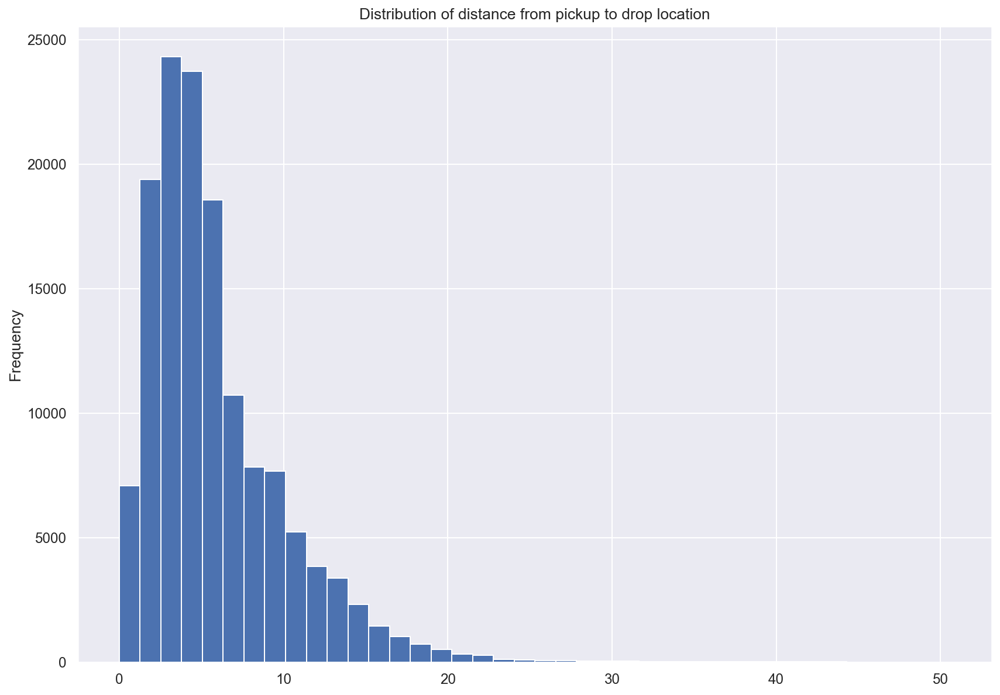

In [61]:
# Summary statistics of distance
display(df['distance'].agg([max, min, np.mean, np.median]))

fig, ax = plt.subplots()
df['distance'].plot(bins=40, ax= ax, kind='hist',title='Distribution of distance from pickup to drop location')
plt.show()

## Number of Rejections 

Text(0.5, 1.0, 'Distribution of Number of Rejections Per Job')

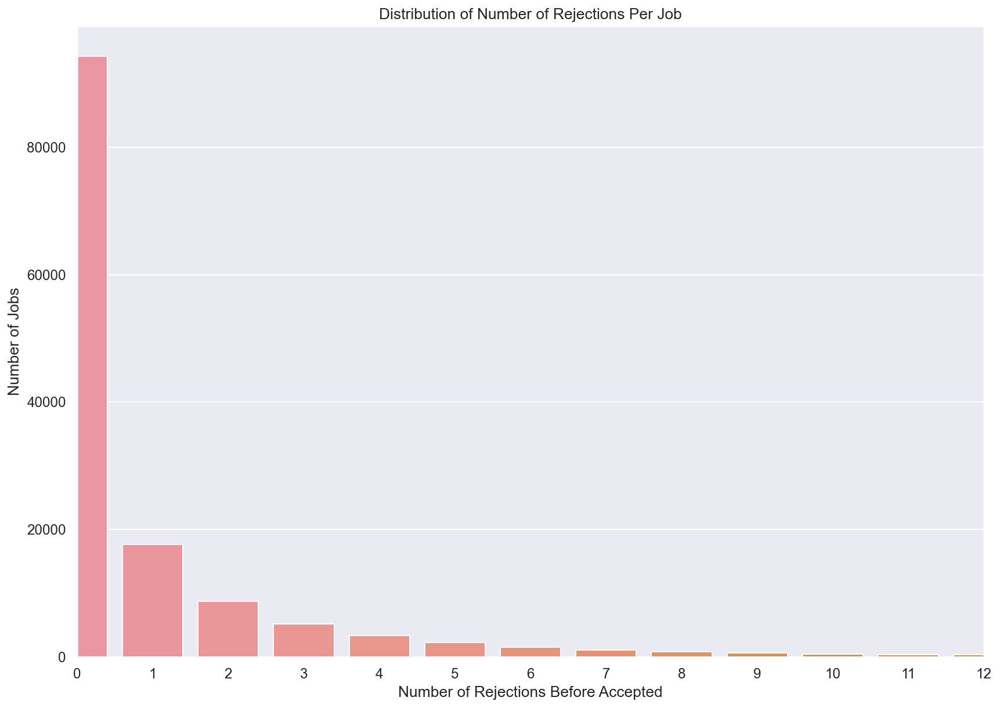

In [62]:
df['rejected_count'].value_counts()

# Plot status of canceled jobs on bar chart
ax = sns.barplot(x=df['rejected_count'].value_counts().index, y=df['rejected_count'].value_counts(), data= df)
ax.set_ylabel('Number of Jobs')
ax.set_xlabel('Number of Rejections Before Accepted')
ax.set_xlim(0, 12)
ax.set_xticklabels(ax.get_xticklabels())
ax.set_title('Distribution of Number of Rejections Per Job')

The figure above shows that the most jobs get accepted very early on; over 67% are accepted by the first courier the job is offered to. over 90% of jobs are accepted by the fourth courier that a job is offered to (see the percentiles below). Note that the "number of courier offers needed to get accepted" is equal to the "number of rejection" + 1.

In [63]:
rej_count_cum_freq = df['rejected_count'].value_counts().cumsum()

In [64]:
# Create data frame showing cumulative frequency of rejected_count
rej_count_cum_freq_norm = pd.DataFrame(rej_count_cum_freq/rej_count_cum_freq.max()*100).reset_index()
# Rename columns
rej_count_cum_freq_norm = rej_count_cum_freq_norm.rename(columns = \
                                                         {'index':'rejected_count', 'rejected_count':'percentile'})

In [65]:
# Output data frame showing percentiles for each rejected_count value
rej_count_cum_freq_norm.head(10)

,rejected_count,percentile
0,0,67.859225
1,1,80.544820
2,2,86.799093
3,3,90.504156
4,4,92.909425
5,5,94.515096
6,6,95.583144
7,7,96.366188
8,8,96.956350
9,9,97.387455


Text(0.5, 1.0, 'Cumulative Frequency Graph for Number of Rejections')

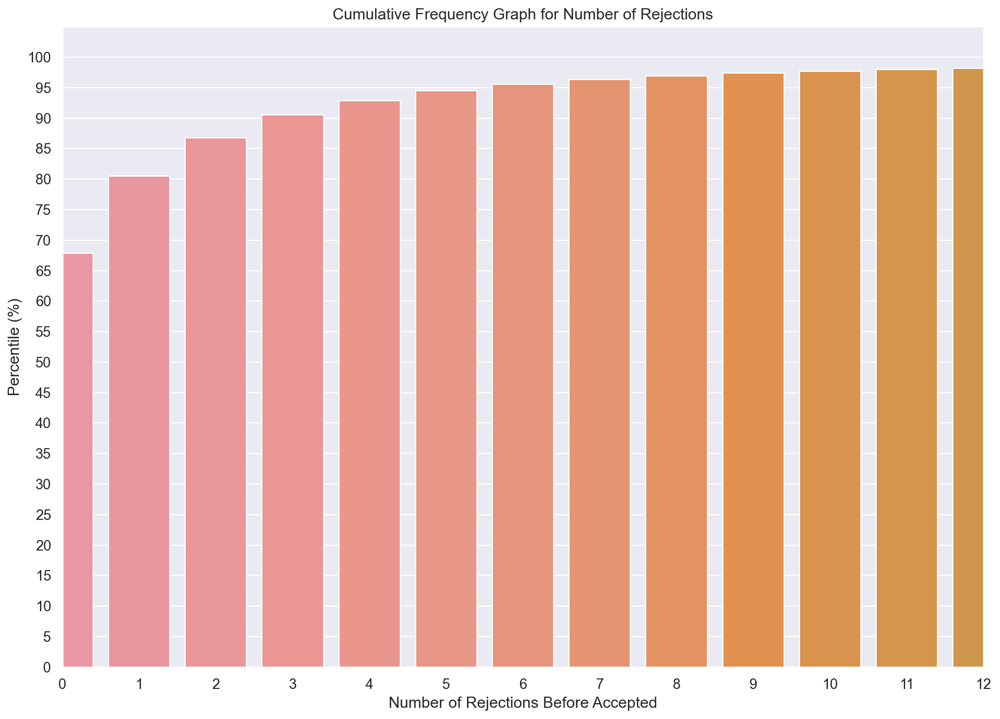

In [66]:
# Plot percentiles for different rejected_count
ax = sns.barplot(x=rej_count_cum_freq_norm['rejected_count'], y=rej_count_cum_freq_norm['percentile'], \
                 data= rej_count_cum_freq_norm)
ax.set_ylabel('Percentile (%)')
ax.set_xlabel('Number of Rejections Before Accepted')
ax.set_xlim(0, 12)
ax.set_yticks(np.linspace(start = 0, stop = 100, num=21))
ax.set_xticklabels(ax.get_xticklabels())
ax.set_title('Cumulative Frequency Graph for Number of Rejections')

Text(0.5, 1.0, 'Number of rejected in %')

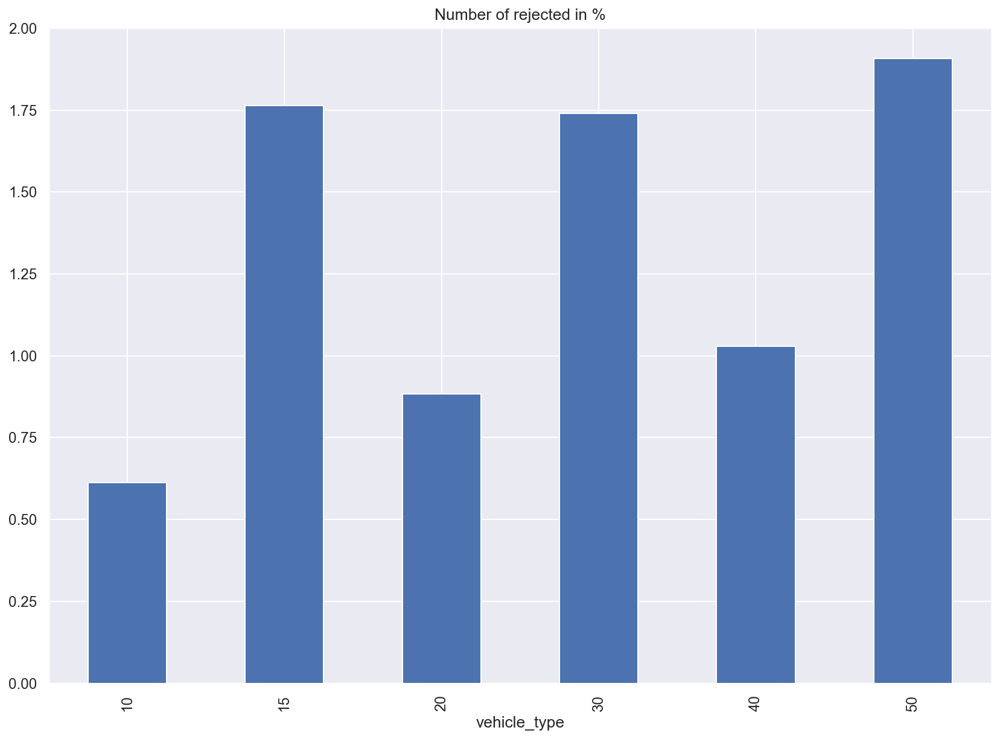

In [67]:
# Plot of rejections percentage by vehicle type
df_vehicle_type = df.groupby('vehicle_type')['is_accepted'].agg(['sum','count']) 
df_vehicle_type['is_rejected_prop'] = 100*(1-(df_vehicle_type['sum'] / df_vehicle_type['count']))

df_vehicle_type['is_rejected_prop'].plot(kind='bar')
plt.title('Number of rejected in %')

## Cyclic Features

We also want to have a look at datetime data. This data is special as a single variable can be visualized by multiple cycles underlying the datetime. This section also works on the event based data, so it's a visualization of single accepted and rejected events, not the corresponding jobs.

We can look at the distribution of job events looking at the hours of a day, the day of a week or the month of a year, among many other possibilites.

We pick the datetime variable 'earliest_pickup_time' for visualization, which also is the basis for the definition of morning and evening jobs.

We first read the event based dataset

In [68]:
df_events = pd.read_feather(utils.path_to('data', 'final', 'df_clean_events.feather'))

Prior to visualization, we look at the distribution of our datetime variable

In [69]:
dt = df_events.earliest_pickup_time
dt.describe()

count                  325635
unique                  46057
top       2018-06-29 07:00:00
freq                      233
first     2018-01-01 12:15:00
last      2020-03-03 14:30:10
Name: earliest_pickup_time, dtype: object

If we want to look at the yearly cycle, we should restrict the daterange to one year period, as the cyclic plots don't account for months with data from one or from two years (June would give higher bars than August as we have June 2018 and June 2019 but only August 2018 in the current dataset). We choose July 2018 to June 2019.

In [70]:
dt_18_19 = dt[((dt.dt.year == 2018) & (dt.dt.month > 6)) | 
              ((dt.dt.year == 2019) & (dt.dt.month <= 6))]
# dt_18 = dt[dt.dt.year == 2018]  # if you just want to look at 2018

Now we look at our outcome variable. We want to examine the rejection rate

In [71]:
event = df_events.event
print(event.describe())

count       325635
unique           2
top       rejected
freq        178628
Name: event, dtype: object


In [72]:
print(event.value_counts())

rejected    178628
accepted    147007
Name: event, dtype: int64


We have to recode the event from a categorical to a binary variable

In [73]:
outcome = (event == 'rejected').astype('float')
print(outcome.value_counts())

1.0    178628
0.0    147007
Name: event, dtype: int64


Now we check the rejection rate of weekdays, so we can check if our plots show something we can believe in

In [74]:
# check plausibility
pd.DataFrame({'datetime': dt, 'dayofweek': dt.dt.dayofweek, 'outcome': outcome}).groupby('dayofweek').mean()

,outcome
dayofweek,
0,0.561298
1,0.548798
2,0.541268
3,0.565778
4,0.581178
5,0.366737
6,0.389124


Surprising - the rejection rate on weekends is much lower than on workdays

There are different possibilities for coloring a color chart, see https://matplotlib.org/tutorials/colors/colormaps.html. Here we define our choice

In [75]:
# Set the colormap
colormap = plt.cm.plasma
# Set transparency
alpha = 1

In [76]:
# override the seaborn style setting for having smaller bars printed
force_edgecolor = plt.rcParams["patch.force_edgecolor"]
plt.rcParams["patch.force_edgecolor"] = False

First, we look at the job offers per day of the year. The work is done by our function cyclic_chart, which takes the cycle type as a first argument, followed by the number of bins, the datetime variable, the outcome variable, colormap and transparency.

The height of the cyclic bar corresponds to the total number of job offer events per day of the year, the colour corresponds to the rejection rate.

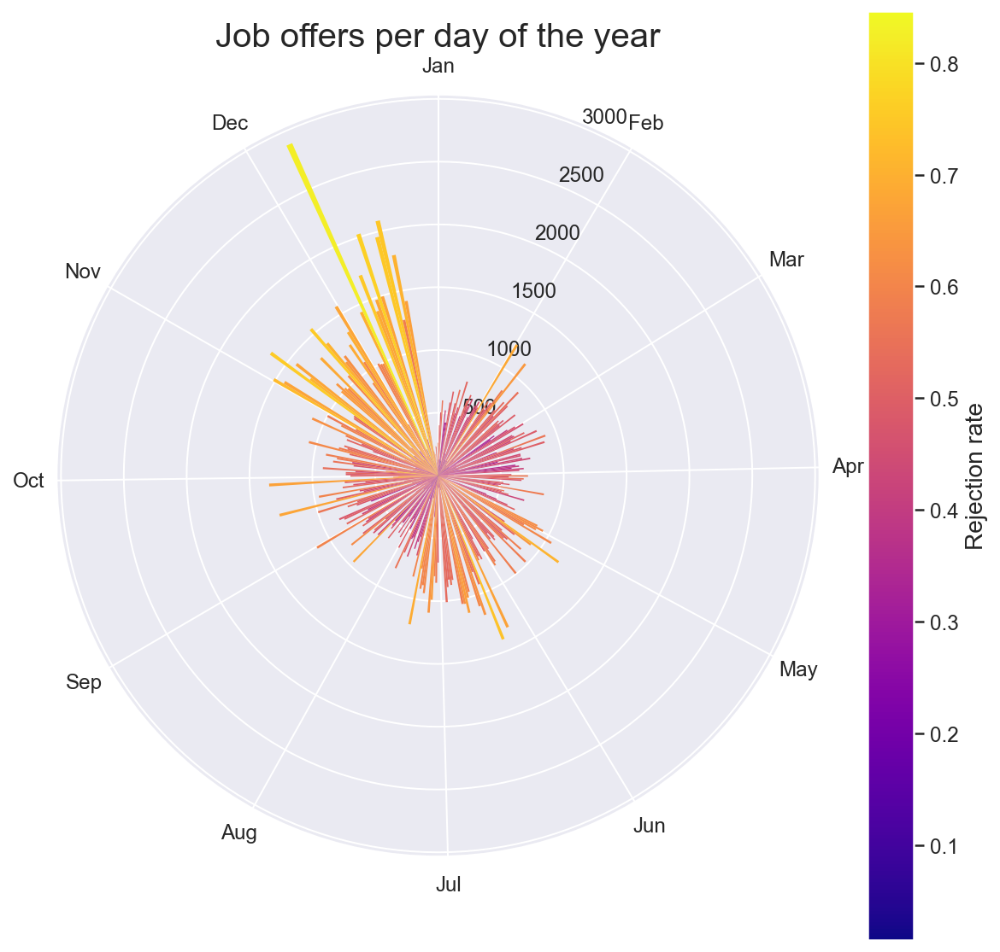

In [77]:
fig = plt.figure(figsize = (10, 10))
ax, cbar = cyclic_chart(CYCLE_YEAR, 365, dt_18_19, indicator=outcome, cmap=colormap, alpha=alpha)
ax.set_title("Job offers per day of the year", fontdict={'fontsize': '20', 'fontweight' : '3'})
cbar.set_label("Rejection rate", fontdict={'fontsize': '14', 'fontweight' : '2'})
plt.show()

The following figure shows the number of jobs per quarter of an hour during a day, again with the rejection rate.

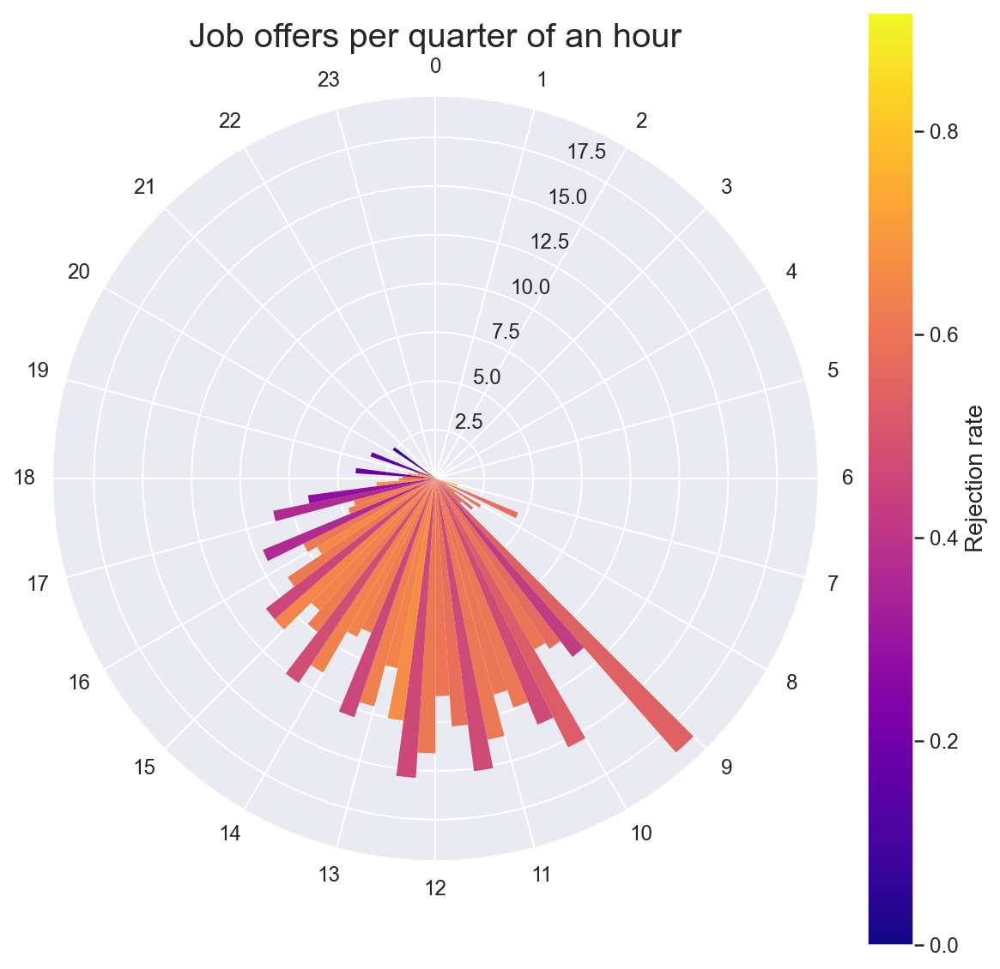

In [78]:
fig = plt.figure(figsize = (10, 10))
ax, cbar = cyclic_chart(CYCLE_DAY, 24 * 4, dt, indicator=outcome, cmap=colormap, alpha=alpha)
ax.set_title("Job offers per quarter of an hour", fontdict={'fontsize': '20', 'fontweight' : '3'})
cbar.set_label("Rejection rate", fontdict={'fontsize': '14', 'fontweight' : '2'})
plt.show()

The rejections in the evening seem to be very low. Also, the second quarter of an hour has a lower rejection rate than the other three quarters.

Now the jobs per half day during the course of a week.

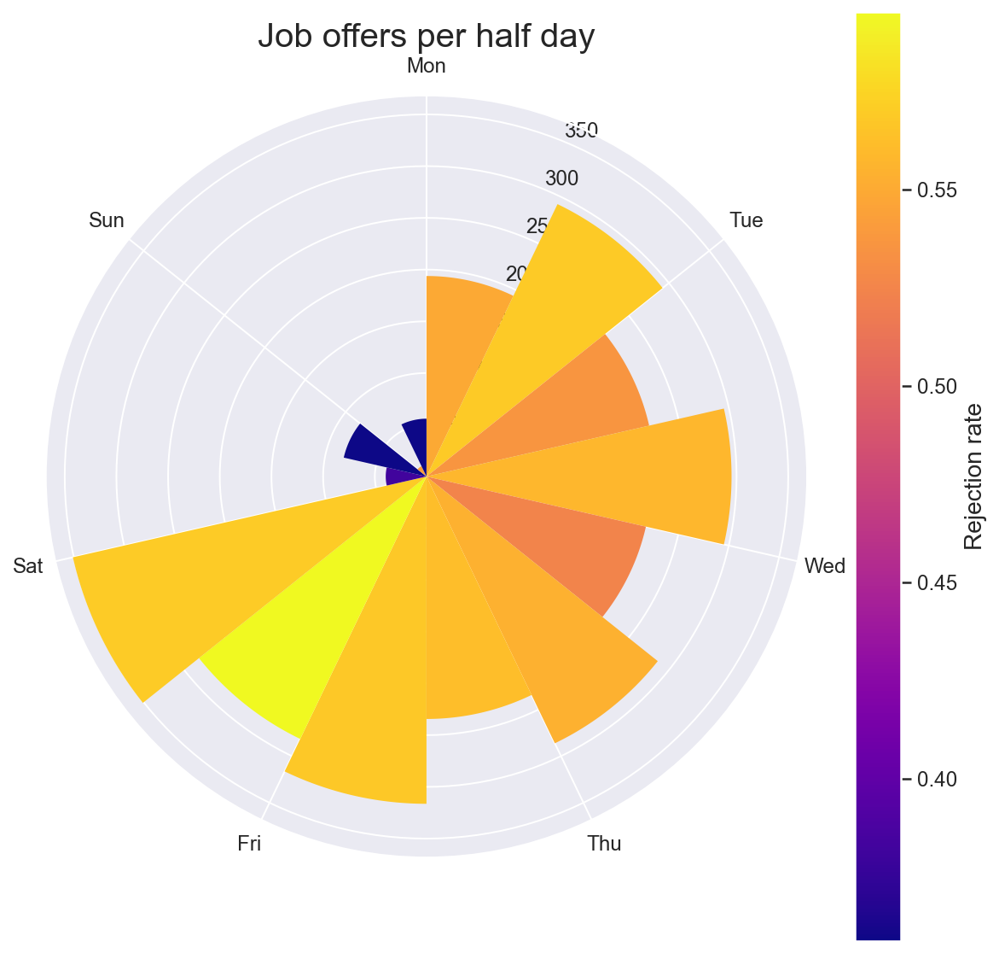

In [79]:
fig = plt.figure(figsize = (10, 10))
ax, cbar = cyclic_chart(CYCLE_WEEK, 7 * 2, dt, indicator=outcome, cmap=colormap, alpha=alpha)
ax.set_title("Job offers per half day", fontdict={'fontsize': '20', 'fontweight' : '3'})
cbar.set_label("Rejection rate", fontdict={'fontsize': '14', 'fontweight' : '2'})
plt.show()

Friday before noon is a tough one with a higher rejection rate. Weekend jobs generally get accepted quite fast.

We can also plot several figures beside.
The following plots show job offers, starting from top left and then line by line:

- per hours of the day - per quarter of an hour (same as above)
- per day of the week - per hour of the week
- per month of the year* - per day of the year
(The month of the year is a bit rough, just 12 equal parts of the year, doesn't account for different month lengths. But the scale label is correct).

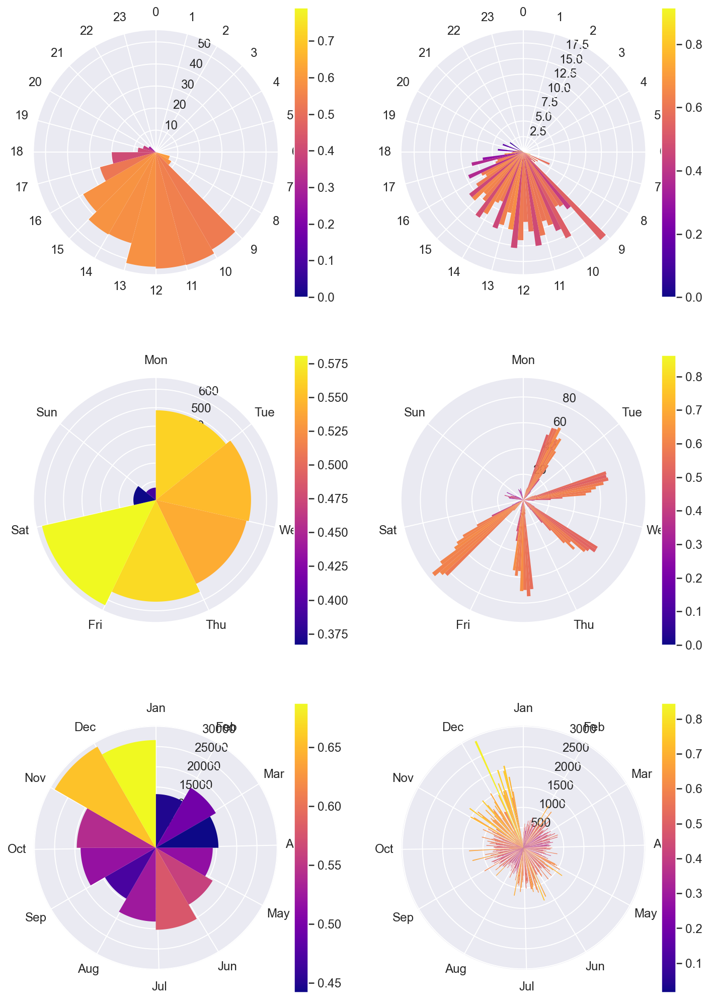

In [80]:
fig = plt.figure(figsize = (12, 18))
ax, cbar = cyclic_chart(CYCLE_DAY, 24, dt, indicator=outcome, subplot=321, cmap=colormap, alpha=alpha)
ax, cbar  = cyclic_chart(CYCLE_DAY, 24 * 4, dt, indicator=outcome, subplot=322, cmap=colormap, alpha=alpha)
ax, cbar  = cyclic_chart(CYCLE_WEEK, 7, dt, indicator=outcome, subplot=323, cmap=colormap, alpha=alpha)
ax, cbar  = cyclic_chart(CYCLE_WEEK, 7 * 24, dt, indicator=outcome, subplot=324, cmap=colormap, alpha=alpha)
ax, cbar  = cyclic_chart(CYCLE_YEAR, 12, dt_18_19, indicator=outcome, subplot=325, cmap=colormap, alpha=alpha)
ax, cbar  = cyclic_chart(CYCLE_YEAR, 365, dt_18_19, indicator=outcome, subplot=326, cmap=colormap, alpha=alpha)
plt.show()

In [81]:
# Restore seaborn style setting
plt.rcParams["patch.force_edgecolor"] = force_edgecolor

## Weather Data

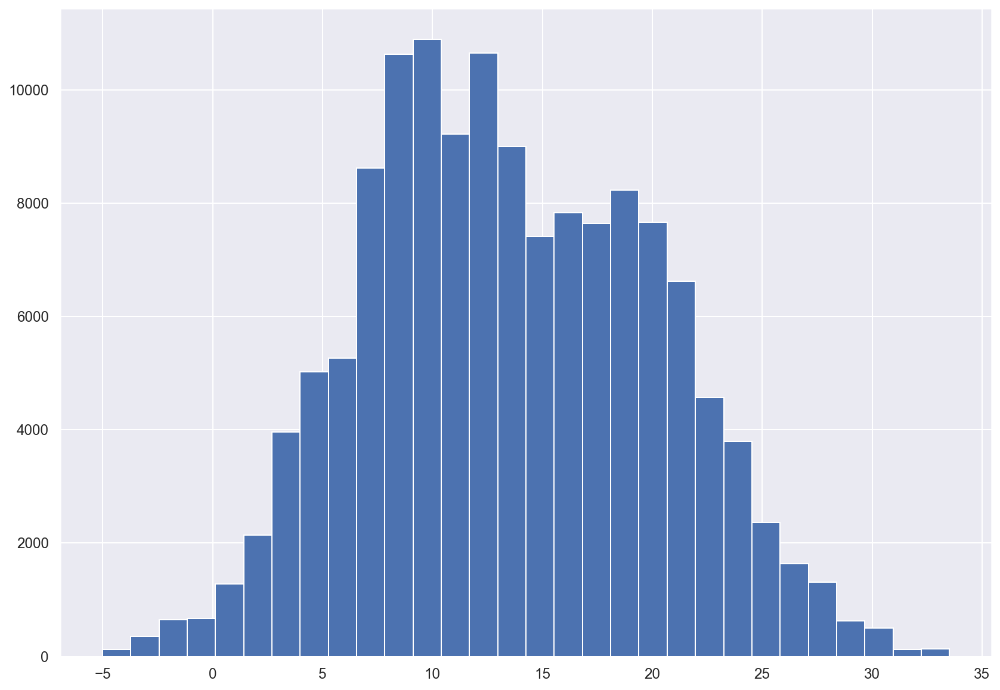

In [82]:
# distribution of temperature for jobs in degree celsius
df['temp'].hist(bins=30)
plt.show()

In [83]:
df[['temp', 'feels_like', 'humidity', 'wind_speed', 'clouds_all','weather_main', 'weather_icon', 'is_daytime']].head()

,temp,feels_like,humidity,wind_speed,clouds_all,weather_main,weather_icon,is_daytime
0,6.77,4.16,76,1.54,100,Rain,10d,1
1,7.19,5.38,76,0.51,90,Clouds,04d,1
2,7.19,5.38,76,0.51,90,Clouds,04d,1
3,7.12,2.58,81,4.63,100,Rain,10d,1
4,6.60,2.65,80,3.60,75,Clouds,04d,1


In [84]:
df['weather_main'].value_counts()

Clouds          91588
Clear           31938
Rain            10642
Haze             2679
Drizzle           775
Mist              768
Snow              319
Thunderstorm      167
Fog                69
Name: weather_main, dtype: int64

New_categories = {Clear: Clear, Precipitation:(Rain, Drizzle, Snow, Thunderstorm), Cloudy:(Clouds, Haze, Mist, Fog)}

## Correlations Between Variables

In [85]:
# Function to plot scatter plots of all columns (specified as a list) in a given data frame
def plot_correlations(df, cols):
    
    return(sns.pairplot(df[cols]))

#### Which columns should be log transformed?

Many of the columns are heavily left-skewed (as can be seen from the plots below). The most common way of dealing with skewed features is to log transform them. Only numerical columns that are skewed should be log transformed. Before applying a log transformation, however, it is important to verify the skewness of the data, as well as verify that the log transformation reduces the skewness through a visual check of the new log transformed distributions.

The following code is used to pick out columns that are numerical, continuous, and skewed.

In [86]:
#get the dataframe showing data types of columns
df_column_dtypes = pd.DataFrame(df.dtypes).reset_index()

In [87]:
df_column_dtypes = df_column_dtypes.rename(columns = {'index': 'column_name', 0: 'dtype'})

In [88]:
df_column_dtypes.head()

,column_name,dtype
0,job_id,int64
1,status,int64
2,pickup_postcode,object
3,pickup_location_lat,float64
4,pickup_location_lng,float64


In [89]:
# create list of numerical columns i.e. columns name that have dtype of int64 or float64
numerical_value_cols = [df_column_dtypes['column_name'][i] for i in range(0, len(df_column_dtypes.index)) \
                     if (str(df_column_dtypes['dtype'][i]) =='int64')\
                     or (str(df_column_dtypes['dtype'][i]) =='float64')]

In [90]:
#list of strings to filter non numerical columns
str_exclude_lst = ['is_', 'lat' ,'lng', 'count']

In [91]:
to_logtrans_cols = [col for col in numerical_value_cols if 'is_' not in col]

In [92]:
# Remove categorical columns, unskwed columns etc., only keeping skewed, continuous columns
to_logtrans_cols = [col for col in to_logtrans_cols if 'lat' not in col]
to_logtrans_cols = [col for col in to_logtrans_cols if 'lng' not in col]
to_logtrans_cols = [col for col in to_logtrans_cols if 'count' not in col]
to_logtrans_cols = [col for col in to_logtrans_cols if 'status' not in col]

to_logtrans_cols = [col for col in to_logtrans_cols if col not in {'job_id','vehicle_type','job_priority' \
                                                                  ,'riskiness', 'show_on_board', 
                                                                  'special_care', 'temp', 'feels_like' \
                                                                  ,'humidity', 'wind_speed', 'clouds_all'}]

In [93]:
# Print column names that need to be log transformed
to_logtrans_cols

['distance',
 'courier_money_earned_net',
 'size_x',
 'size_y',
 'size_z',
 'weight',
 'estimated_journey_time',
 'courier_earnings_calc']

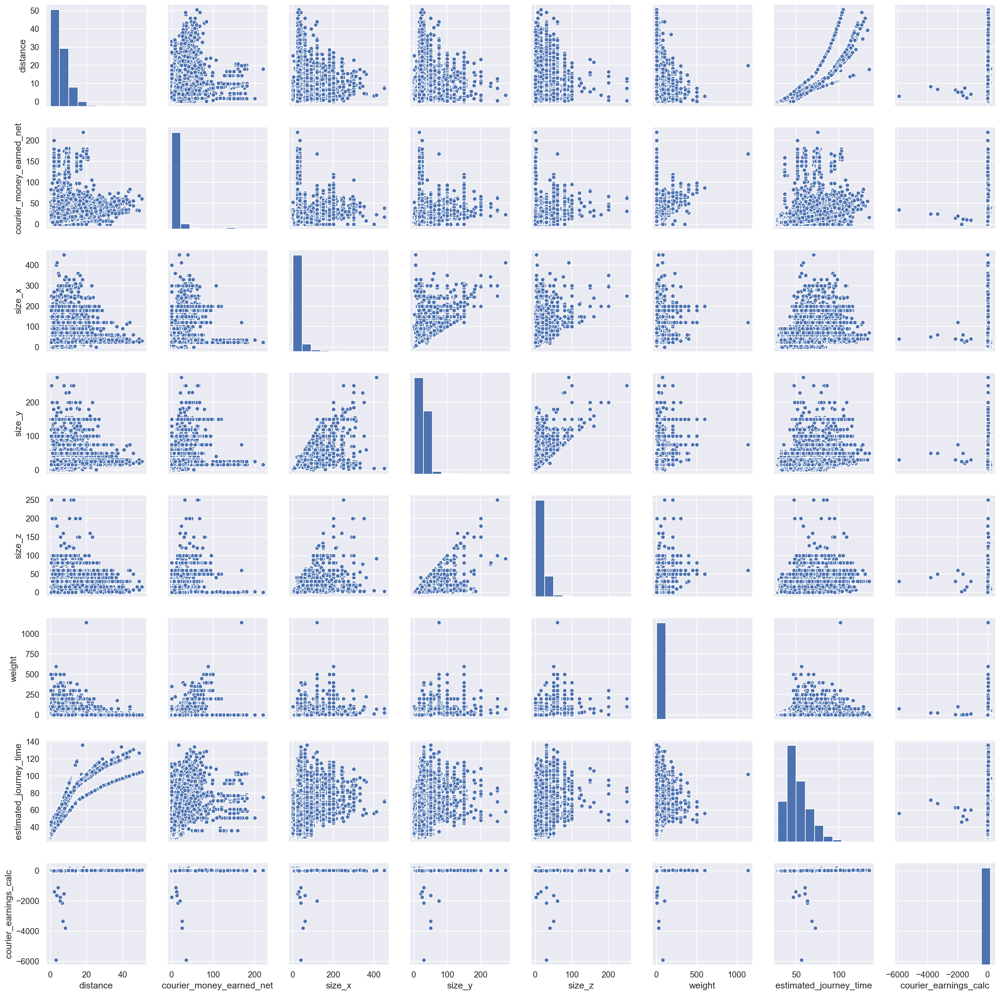

In [94]:
# Plot correlations of continuous numerical columns
plot_correlations(df, to_logtrans_cols)

The plots above visually demonstrate the correlation between the different continuous numerical columns of data. The plots clearly demonstrate a left-skweness. 

In [95]:
# Function to create a new data frame that is the natural log of values in a given data frame
def log_transform_df(df, cols):
    
    # Filter out rows with values >0, to prevent returning inf
    df_log = np.log(df[df[cols]>0][cols])
    
    return df_log

In [96]:
df_log_trans = log_transform_df(df,to_logtrans_cols)

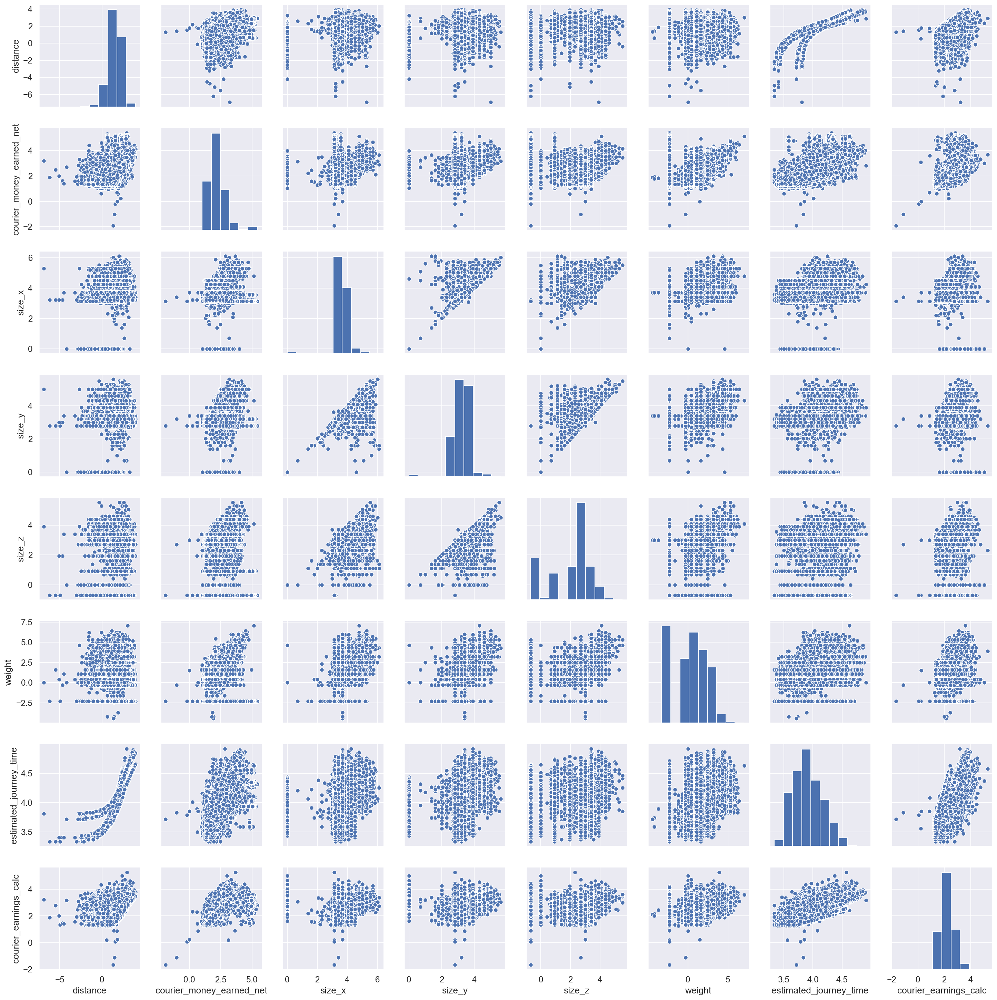

In [97]:
# Plot correlations for log transformed columns
plot_correlations(df_log_trans, to_logtrans_cols)

The plots above show the correlations between the columns after they have been log transformed. It can also be seen that carrying out the log transformation has diminished the skewness of the features; the logarithmic value have a greater spread.

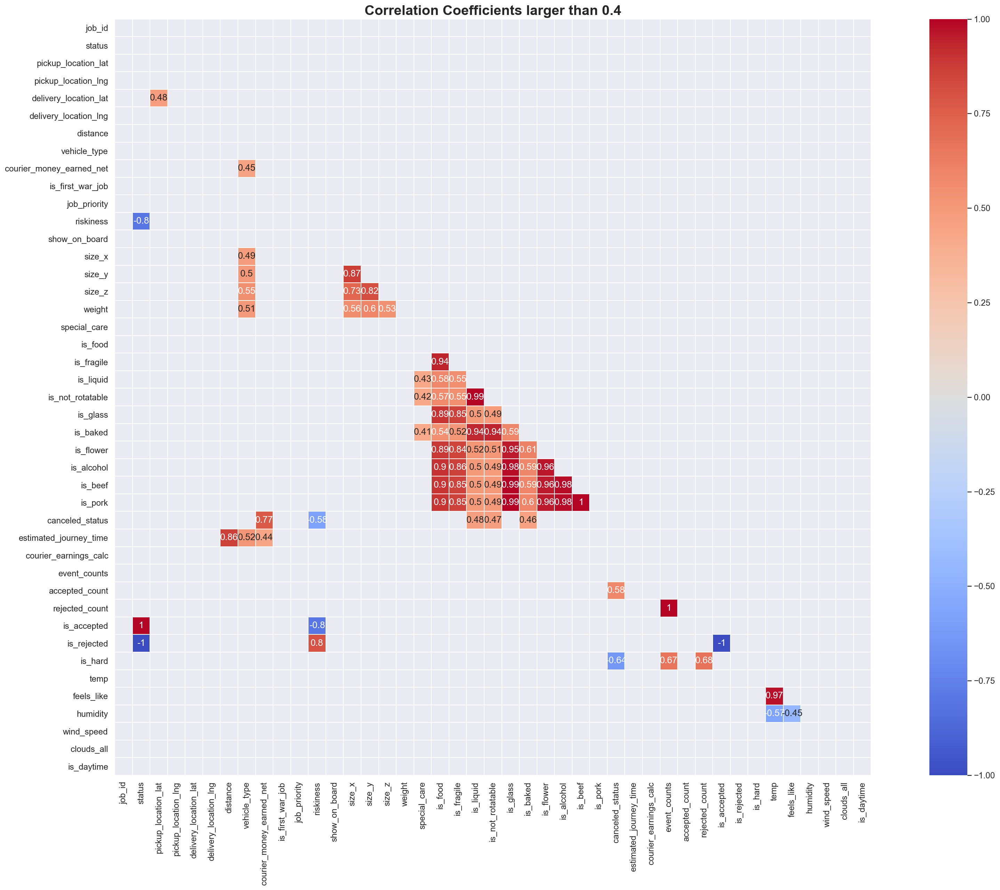

In [98]:
# Overview correlation analysis
df_corr = df.corr()

# mask for the upper triangle
mask = np.zeros_like(df_corr, dtype = np.bool)
mask[np.triu_indices_from(mask)] = True
# Thresholding correlations
df_corr[np.abs(df_corr) < 0.4] = None

# figure
df_corr.style.background_gradient().set_precision(2)
plt.figure(figsize = (30, 20))
ax = plt.axes()
sns.heatmap(df_corr, mask = mask, cmap = 'coolwarm', annot = True, center = 0, square = True, linewidths = 0.5, ax = ax)
ax.set_title('Correlation Coefficients larger than 0.4', fontweight = "bold", fontsize = 20)
plt.show()

Finally, the chart above is a heatmap showing the correlation between different features. Only correlations with an R-squared value of 0.4 have been shown.